Microdados ENEM 2016

In [7]:
#%matplotlib notebook
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
from matplotlib import colors 
from matplotlib.ticker import PercentFormatter 
import matplotlib.ticker as ticker
import seaborn as sns
import scipy.stats as stats


pd.set_option("display.precision", 13)

In [8]:
def formatarDataframe(df_original, titulo, coluna_esquerda, coluna_centro):
    df_styler = df_original.style.set_caption(titulo)
    df_styler.set_properties(subset=coluna_esquerda,**{'text-align': 'left'}).hide()
    df_styler.set_properties(subset=coluna_centro,**{'text-align': 'center'})
    df_styler.set_table_styles([dict(selector='th', props=[('text-align', 'center')])])
    return df_styler

Para melhor uso de recursos computacionais, realizamos uma etapa de pré-processamento. Nessa etapa, convertemos o arquivo CSV para Parquet, um tipo de arquivo mais adequado para lidar com grandes volumes de dados em ciência de dados. Com isso, conseguimos reduzir o tamanho do arquivo e o  tempo de leitura e escrita.

In [9]:
df_microdados_enem = pd.read_parquet("microdados_enem_2016.parquet", engine="fastparquet")

In [10]:
len(df_microdados_enem)

8627367

In [11]:

total_estudantes = len(df_microdados_enem)
situacao_conclusao_dict = {
    "Já concluí o Ensino Médio" : 1,
    "Estou cursando e concluirei o Ensino Médio em 2016" : 2,
    "Estou cursando e concluirei o Ensino Médio após 2016" : 3,
    "Não concluí e não estou cursando o Ensino Médio" : 4
}
situacao_conclusao_descricao = list(situacao_conclusao_dict.keys())
situacao_conclusao_quantidade = df_microdados_enem["TP_ST_CONCLUSAO"].value_counts().values
questao_46_quantidade = df_microdados_enem["Q046"].value_counts().values
situacao_conclusao_percentual = []
for item in situacao_conclusao_quantidade:
    situacao_conclusao_percentual.append(item/total_estudantes)

● Tabulação da variável de Situação de conclusão do Ensino Médio antes dos filtros (TP_ST_CONCLUSAO), com as legendas de cada valor numérico.

In [12]:
df_situacao_conclusao = pd.DataFrame({"Descrição": situacao_conclusao_descricao, 
                                      "Quantidade": situacao_conclusao_quantidade,
                                      "Percentual": situacao_conclusao_percentual})

df_situacao_conclusao_formatado = formatarDataframe(df_situacao_conclusao, 
               'Tabela 1: Tabulação da variável TP_ST_CONCLUSAO', 
               ["Descrição"], 
               ["Quantidade"])
df_situacao_conclusao_formatado.format({'Percentual': "{:,.2%}"})
display(df_situacao_conclusao_formatado)

#Calcular o percentual

Descrição,Quantidade,Percentual
Já concluí o Ensino Médio,4928251,57.12%
Estou cursando e concluirei o Ensino Médio em 2016,1882278,21.82%
Estou cursando e concluirei o Ensino Médio após 2016,1344085,15.58%
Não concluí e não estou cursando o Ensino Médio,472753,5.48%


● Tabulação cruzada da variável TP_ST_CONCLUSAO e da resposta no questionário socioeconômica da Q046 Você já concluiu ou está concluindo o Ensino Médio?

In [13]:
questao_46_percentual = []
for item in questao_46_quantidade:
    questao_46_percentual.append(item/total_estudantes)

df_situacao_conclusao_questao_46 = pd.DataFrame({"Descrição": situacao_conclusao_descricao, 
                                                 "TP_ST_CONCLUSAO": situacao_conclusao_quantidade,
                                                 "Percentual 1": situacao_conclusao_percentual,
                                                 "Q046": questao_46_quantidade,
                                                 "Percentual 2": questao_46_percentual})

df_situacao_conclusao_questao_46_formatado = formatarDataframe(df_situacao_conclusao_questao_46, 
               'Tabela 2: Tabulação cruzada da variável TP_ST_CONCLUSAO e Q046', 
               ["Descrição"], 
               ["TP_ST_CONCLUSAO", "Q046", "Percentual 1", "Percentual 2"])

df_situacao_conclusao_questao_46_formatado.format({'Percentual 1': "{:,.2%}",
                                                  'Percentual 2': "{:,.2%}"})

display(df_situacao_conclusao_questao_46_formatado)

Descrição,TP_ST_CONCLUSAO,Percentual 1,Q046,Percentual 2
Já concluí o Ensino Médio,4928251,57.12%,4947935,57.35%
Estou cursando e concluirei o Ensino Médio em 2016,1882278,21.82%,1872570,21.70%
Estou cursando e concluirei o Ensino Médio após 2016,1344085,15.58%,1331073,15.43%
Não concluí e não estou cursando o Ensino Médio,472753,5.48%,475785,5.51%


In [14]:
ano_conclusao_dict = {
    "Não informado" : 0,
    "2015" : 1,
    "2014" : 2,
    "2013" : 3,
    "2012" : 4,
    "2011" : 5,
    "2010" : 6,
    "2009" : 7,
    "2008" : 8,
    "2007" : 9,
    "Anterior a 2007" : 10
}
ano_conclusao_descricao = list(ano_conclusao_dict.keys())
ano_conclusao_quantidade = df_microdados_enem["TP_ANO_CONCLUIU"].value_counts().sort_index().values
ano_conclusao_percentual = []
for item in ano_conclusao_quantidade:
    ano_conclusao_percentual.append(item/total_estudantes)

● Tabulação da variável de ano de conclusão do Ensino Médio (TP_ANO_CONCLUIU), com as legendas de cada valor numérico.

In [15]:
df_ano_conclusao = pd.DataFrame({"Descrição": ano_conclusao_descricao, 
                                 "Quantidade": ano_conclusao_quantidade,
                                 "Percentual": ano_conclusao_percentual})
df_ano_conclusao_formatado = formatarDataframe(df_ano_conclusao, 'Tabela 3: Tabulação da variável TP_ANO_CONCLUIU', ["Descrição"], ["Quantidade", "Percentual"])
df_ano_conclusao_formatado.format({'Percentual': "{:,.2%}"})
display(df_ano_conclusao_formatado)

#Colocar percentual

Descrição,Quantidade,Percentual
Não informado,3699116,42.88%
2015,966842,11.21%
2014,699987,8.11%
2013,527310,6.11%
2012,416454,4.83%
2011,317364,3.68%
2010,294214,3.41%
2009,244461,2.83%
2008,199619,2.31%
2007,178091,2.06%


● Tabulação da variável de tipo de ensino (TP_ENSINO), com as legendas de cada valor numérico.

In [16]:
ensino_dict = {
    "Ensino Regular" : 1,
    "Educação Especial - Modalidade Substitutiva" : 2,
    "Educação de Jovens e Adultos" : 3
}
ensino_descricao = list(ensino_dict.keys())
ensino_quantidade = df_microdados_enem["TP_ENSINO"].value_counts().sort_index().values
ensino_percentual = []
for item in ensino_quantidade:
    ensino_percentual.append(item/total_estudantes)

In [17]:
df_ensino = pd.DataFrame({"Descrição": ensino_descricao, 
                          "Quantidade": ensino_quantidade,
                          "Percentual": ensino_percentual})
df_ensino_formatado = formatarDataframe(df_ensino, "Tabela 4: Tabulação da variável TP_ENSINO", ["Descrição"], ["Quantidade", "Percentual"])
df_ensino_formatado.format({'Percentual': "{:,.2%}"})
display(df_ensino_formatado)
#Colocar percentual

Descrição,Quantidade,Percentual
Ensino Regular,1652485,19.15%
Educação Especial - Modalidade Substitutiva,10295,0.12%
Educação de Jovens e Adultos,218532,2.53%


● Conferir o formato da variável CO_ESCOLA.

In [18]:
codigo_escola_quantidade = df_microdados_enem["CO_ESCOLA"].value_counts().sort_index().values
codigo_escola = df_microdados_enem["CO_ESCOLA"].value_counts().sort_index().index

In [19]:
codigo_escola_substituindo_nan = df_microdados_enem["CO_ESCOLA"].str.len().fillna(0).astype(int)
codigo_escola_tamanho = codigo_escola_substituindo_nan.value_counts().index
codigo_escola_tamanho_quantidade = codigo_escola_substituindo_nan.value_counts().values
codigo_escola_tamanho_percentual = []
for item in codigo_escola_tamanho_quantidade:
    codigo_escola_tamanho_percentual.append(item/total_estudantes)

In [20]:
df_codigo_escola_tamanho = pd.DataFrame({"Tamanho": codigo_escola_tamanho, 
                                         "Quantidade": codigo_escola_tamanho_quantidade,
                                         "Percentual": codigo_escola_tamanho_percentual})
df_codigo_escola_tamanho_formatado = formatarDataframe(df_codigo_escola_tamanho, "Tabela 5: Tamanho da variável CO_ESCOLA.", ["Tamanho"], ["Quantidade", "Percentual"])
df_codigo_escola_tamanho_formatado.format({'Percentual': "{:,.2%}"})
display(df_codigo_escola_tamanho_formatado)

#Tabulação ST_CONCLUSAO e CO_ESCOLA

Tamanho,Quantidade,Percentual
0,6746085,78.19%
8,1881282,21.81%


In [21]:
situacao_conclusao_codigo_escola_descricao = ["Estudantes (sem filtro)",
                                              "Estudantes que possuem código escola",
                                              "Estudantes que já concluíram o EM e possuem código escola",
                                              "Estudantes que concluirão o EM em 2016 e possuem código escola",
                                              "Estudantes que concluirão o EM após 2016 e possuem código escola",
                                              "Estudantes que não concluíram e não estão cursando o EM"]

co_escola_cond_1 = df_microdados_enem.loc[(df_microdados_enem['CO_ESCOLA'].notnull()) & (df_microdados_enem['TP_ST_CONCLUSAO'] == 1)]
co_escola_cond_2 = df_microdados_enem.loc[(df_microdados_enem['CO_ESCOLA'].notnull()) & (df_microdados_enem['TP_ST_CONCLUSAO'] == 2)]
co_escola_cond_3 = df_microdados_enem.loc[(df_microdados_enem['CO_ESCOLA'].notnull()) & (df_microdados_enem['TP_ST_CONCLUSAO'] == 3)]
co_escola_cond_4 = df_microdados_enem.loc[(df_microdados_enem['CO_ESCOLA'].notnull()) & (df_microdados_enem['TP_ST_CONCLUSAO'] == 4)]

tamanho_co_escola_cond_1 = len(co_escola_cond_1)
tamanho_co_escola_cond_2 = len(co_escola_cond_2)
tamanho_co_escola_cond_3 = len(co_escola_cond_3)
tamanho_co_escola_cond_4 = len(co_escola_cond_4)

situacao_conclusao_codigo_escola_quantidade = [total_estudantes,
                                               codigo_escola_tamanho_quantidade[1],
                                               tamanho_co_escola_cond_1,
                                               tamanho_co_escola_cond_2,
                                               tamanho_co_escola_cond_3,
                                               tamanho_co_escola_cond_4]

situacao_conclusao_codigo_escola_percentual = []
for item in situacao_conclusao_codigo_escola_quantidade:
    situacao_conclusao_codigo_escola_percentual.append(item/total_estudantes)

In [22]:
df_situacao_conclusao_codigo_escola = pd.DataFrame({"Descrição": situacao_conclusao_codigo_escola_descricao,
                                                  "Quantidade": situacao_conclusao_codigo_escola_quantidade,
                                                   "Percentual": situacao_conclusao_codigo_escola_percentual})

df_situacao_conclusao_codigo_escola_formatado = formatarDataframe(df_situacao_conclusao_codigo_escola, "Tabela 6: Tabulação das variáveis ST_CONCLUSAO e CO_ESCOLA", ["Descrição"], ["Quantidade","Percentual"])
df_situacao_conclusao_codigo_escola_formatado.format({'Percentual': "{:,.2%}"})
display(df_situacao_conclusao_codigo_escola_formatado)

Descrição,Quantidade,Percentual
Estudantes (sem filtro),8627367,100.00%
Estudantes que possuem código escola,1881282,21.81%
Estudantes que já concluíram o EM e possuem código escola,0,0.00%
Estudantes que concluirão o EM em 2016 e possuem código escola,1881282,21.81%
Estudantes que concluirão o EM após 2016 e possuem código escola,0,0.00%
Estudantes que não concluíram e não estão cursando o EM,0,0.00%


In [23]:
total_estudantes = len(df_microdados_enem)

● Excluir estudantes que não possuam informação de gênero (valores ausentes na variável TP_SEXO)

In [24]:
#Sem valor nulo na coluna
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['TP_SEXO'].isnull()].index, inplace=True)
total_apos_filtro_1 = len(df_microdados_enem)

● Manter na base de dados apenas os alunos que já concluíram o ensino médio ou que irão concluir em 2016 (1 ou 2)

In [25]:
CONCLUIRAO_ENSINO_MEDIO_APOS_2016 = situacao_conclusao_dict.get("Estou cursando e concluirei o Ensino Médio após 2016")
NAO_CONCLUIRAM_ENSINO_MEDIO = situacao_conclusao_dict.get("Não concluí e não estou cursando o Ensino Médio")

In [26]:
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['TP_ST_CONCLUSAO'] == CONCLUIRAO_ENSINO_MEDIO_APOS_2016].index, inplace=True)
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['TP_ST_CONCLUSAO'] == NAO_CONCLUIRAM_ENSINO_MEDIO].index, inplace=True)
total_apos_filtro_2 = len(df_microdados_enem)

#Observação da tabulação anterior

● Excluir estudantes que tenham concluído antes de 2007 (pois não teremos informação do ano específico)

In [27]:
CONCLUIRAM_ANTES_DE_2007 = ano_conclusao_dict.get("Anterior a 2007")

In [28]:
#df.drop(df.loc[df['TP_ANO_CONCLUIU']==0].index, inplace=True)
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['TP_ANO_CONCLUIU'] == CONCLUIRAM_ANTES_DE_2007].index, inplace=True)
total_apos_filtro_3 = len(df_microdados_enem)

● Excluir estudantes que realizaram Ensino Médio no exterior (TP_ESCOLA)

In [29]:
EXTERIOR = 4

In [30]:
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['TP_ESCOLA'] == EXTERIOR].index, inplace=True)
total_apos_filtro_4 = len(df_microdados_enem)

● Manter apenas estudantes que concluíram ou concluirão o Ensino Médio no Ensino regular (TP_ENSINO)

In [31]:
EDUCACAO_ESPECIAL = ensino_dict.get("Educação Especial - Modalidade Substitutiva")
EJA = ensino_dict.get("Educação de Jovens e Adultos")

In [32]:
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['TP_ENSINO'] == EDUCACAO_ESPECIAL].index, inplace=True)
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['TP_ENSINO'] == EJA].index, inplace=True)
total_apos_filtro_5 = len(df_microdados_enem)

● Excluir alunos que estão fazendo a prova como treineiros (IN_TREINEIRO) (Pela definição de treineiro, aqui não deve excluir ninguém adicional)

In [33]:
TREINEIRO = 1

In [34]:
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['IN_TREINEIRO'] == TREINEIRO].index, inplace=True)
total_apos_filtro_6 = len(df_microdados_enem)

● Excluir alunos que não possuem informação da escola de Ensino Médio (informação ausente de CO_ESCOLA)

In [35]:
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['CO_ESCOLA'].isnull()].index, inplace=True)
total_apos_filtro_7 = len(df_microdados_enem)

● Excluir alunos que possuem informações ausentes nas notas, pois usaremos essas variáveis (valores ausentes nas variáveis NU_NOTA_CN, NU_NOTA_CH, NU_NOTA_LC ou NU_NOTA_MT)

In [36]:
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['NU_NOTA_CN'].isna()].index, inplace=True)
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['NU_NOTA_CH'].isna()].index, inplace=True)
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['NU_NOTA_LC'].isna()].index, inplace=True)
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['NU_NOTA_MT'].isna()].index, inplace=True)
df_microdados_enem.drop(df_microdados_enem.loc[df_microdados_enem['NU_NOTA_REDACAO'].isna()].index, inplace=True)
total_apos_filtro_8 = len(df_microdados_enem)

● Tabulação de observações na base original e quantas observações vamos excluindo em cada um dos filtros/restrições realizadas na base (quantidade e percentual das observações excluídos)

In [37]:
filtros_quantidade = [total_estudantes, total_apos_filtro_1, total_apos_filtro_2, total_apos_filtro_3, total_apos_filtro_4, total_apos_filtro_5, total_apos_filtro_6, total_apos_filtro_7, total_apos_filtro_8]
arr = np.array(filtros_quantidade)
result = arr/total_estudantes
filtros_percentual = result.tolist()

In [38]:
filtros_rotulos = ["Base original", "Com informação de gênero", "Já concluíram ou concluirão EM em 2016", "Concluíram após 2007", "Concluíram EM no Brasil", "Concluíram EM no ensino regular", "Não são treineiros", "Com informação presente da escola de EM", "Com informação presente de notas"]

In [39]:
df_filtros = pd.DataFrame({"Quantidade": filtros_quantidade,
                "Percentual": filtros_percentual})

In [40]:
df_filtros.index = filtros_rotulos
df_filtros_formatado = df_filtros.style.format({'Percentual': "{:,.2%}"})
df_filtros_formatado.set_caption("Tabela 7: Tabulação de observações durante aplicação de filtros")
display(df_filtros_formatado)

,Quantidade,Percentual
Base original,8627367,100.00%
Com informação de gênero,8627367,100.00%
Já concluíram ou concluirão EM em 2016,6810529,78.94%
Concluíram após 2007,5726620,66.38%
Concluíram EM no Brasil,5725635,66.37%
Concluíram EM no ensino regular,5496816,63.71%
Não são treineiros,5496816,63.71%
Com informação presente da escola de EM,1652471,19.15%
Com informação presente de notas,1388044,16.09%


● Criar um identificador único que indique observações que possuam exatamente a mesma nota em todas as disciplinas (Ciências da Natureza, Ciências Humanas, Linguagens e Códigos, Matemática, Redação)

In [41]:
colunas_notas = ['NU_NOTA_LC', 'NU_NOTA_CH', 'NU_NOTA_CN', 'NU_NOTA_MT', 'NU_NOTA_REDACAO']
df_microdados_enem['NOTAS_CONCATENADAS'] = df_microdados_enem[colunas_notas].apply(lambda row: ' '.join(row.astype(np.float64).values.astype(str)), axis=1)

● Para cada uma das notas, criar uma variável que indica quantas pessoas possuem o mesmo valor de nota (=1 se for única; 2 se 2 pessoas tiverem exatamente a mesma nota; etc….)

In [42]:
notas_concatenadas_vc = df_microdados_enem['NOTAS_CONCATENADAS'].value_counts(dropna=True, sort=True)
df_notas_concatenadas_vc = pd.DataFrame(notas_concatenadas_vc)
df_notas_concatenadas = df_notas_concatenadas_vc.reset_index()
df_notas_concatenadas.columns = ['Notas', 'Quantidade']
df_notas_concatenadas_formatado = df_notas_concatenadas.style.hide()
df_notas_concatenadas_formatado.set_caption("Tabela 8: Tabulação de observações de unicidade de notas")
display(df_notas_concatenadas_formatado)

#Todas as notas são únicas

Notas,Quantidade
529.2999877929688 545.2000122070312 495.6000061035156 397.3999938964844 740.0,1
500.5 544.2000122070312 446.1000061035156 599.2999877929688 580.0,1
654.5999755859375 636.2999877929688 629.7999877929688 665.2999877929688 840.0,1
612.5 602.5999755859375 611.4000244140625 558.5999755859375 860.0,1
545.4000244140625 521.7999877929688 420.6000061035156 473.3999938964844 540.0,1
670.2999877929688 680.2000122070312 756.4000244140625 836.0999755859375 780.0,1
690.7999877929688 770.2999877929688 655.7000122070312 741.5 920.0,1
643.5999755859375 645.0999755859375 647.2000122070312 624.0 780.0,1
653.0 651.4000244140625 659.7999877929688 887.7000122070312 920.0,1
469.3999938964844 499.1000061035156 416.0 482.6000061035156 600.0,1


● Criar histogramas para cada uma dessas variáveis para entendermos se serão bons identificadores

In [43]:
notas_ciencias_da_natureza_dict = df_microdados_enem['NU_NOTA_CN'].value_counts().to_dict()
notas_ciencias_humanas_dict = df_microdados_enem['NU_NOTA_CH'].value_counts().to_dict()
notas_linguagens_dict = df_microdados_enem['NU_NOTA_LC'].value_counts().to_dict()
notas_matematica_dict = df_microdados_enem['NU_NOTA_MT'].value_counts().to_dict()
notas_redacao_dict = df_microdados_enem['NU_NOTA_REDACAO'].value_counts().to_dict()

In [44]:
notas_ciencias_da_natureza_lista = [key for key, val in notas_ciencias_da_natureza_dict.items() for _ in range(val)]
notas_ciencias_humanas_lista = [key for key, val in notas_ciencias_humanas_dict.items() for _ in range(val)]
notas_linguagens_lista = [key for key, val in notas_linguagens_dict.items() for _ in range(val)]
notas_matematica_lista = [key for key, val in notas_matematica_dict.items() for _ in range(val)]
notas_redacao_lista = [key for key, val in notas_redacao_dict.items() for _ in range(val)]

In [45]:
notas_intervalos = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000]

○ Nota da prova de Ciências da Natureza

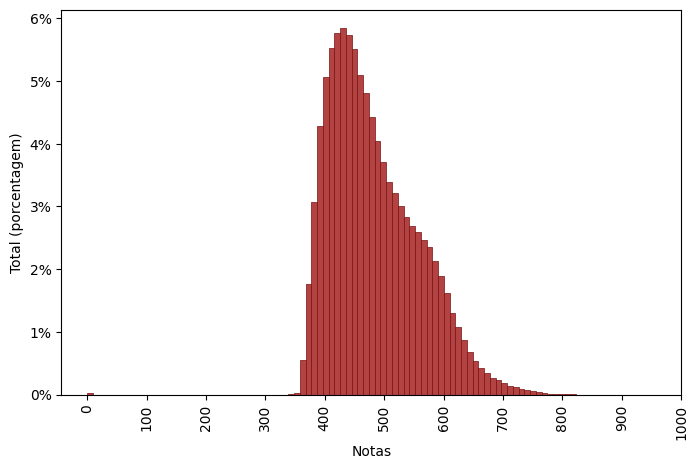

In [46]:
%matplotlib inline
plt.figure(figsize=(8,5)) 
plt.hist(notas_ciencias_da_natureza_lista, weights=np.ones(len(notas_ciencias_da_natureza_lista)) / len(notas_ciencias_da_natureza_lista), bins=90, facecolor = '#b34242', edgecolor='#7a1010', linewidth=0.5) 
plt.xticks(notas_intervalos, notas_intervalos, rotation ='vertical')
plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals = 0))
#plt.title('Gráfico 1: Notas da prova de Ciências da Natureza') 
plt.xlabel('Notas') 
plt.ylabel('Total (porcentagem)')
plt.savefig("notas_cn.png")
plt.show()
#Corrigir eixo

○ Nota da prova de Ciências Humanas

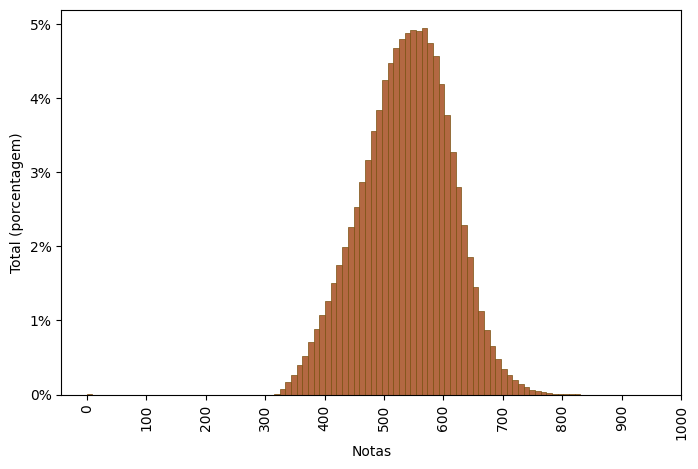

In [47]:
%matplotlib inline
plt.figure(figsize=(8,5)) 
plt.hist(notas_ciencias_humanas_lista, weights=np.ones(len(notas_ciencias_humanas_lista)) / len(notas_ciencias_humanas_lista), bins=90, facecolor = '#b36842', edgecolor='#7a5010', linewidth=0.5)
plt.xticks(notas_intervalos, notas_intervalos, rotation ='vertical')
plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals = 0))
#plt.title('Gráfico 2: Notas da prova de Ciências Humanas') 
plt.xlabel('Notas') 
plt.ylabel('Total (porcentagem)')
plt.savefig("notas_ch.png")
plt.show()
#Corrigir eixos

○ Nota da prova de Linguagens e Códigos

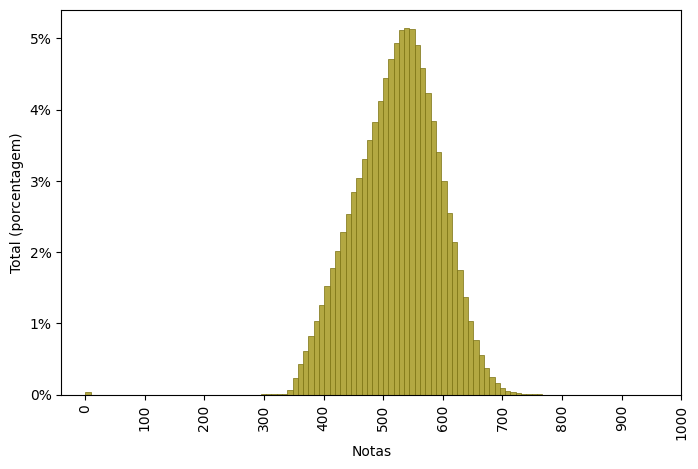

In [48]:
%matplotlib inline
plt.figure(figsize=(8,5))
plt.hist(notas_linguagens_lista, weights=np.ones(len(notas_linguagens_lista)) / len(notas_linguagens_lista), bins=90, facecolor = '#b3a842', edgecolor='#7a7110', linewidth=0.5)
plt.xticks(notas_intervalos, notas_intervalos, rotation ='vertical')
plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals = 0))
#plt.title('Gráfico 3: Notas da prova de Linguagens e Códigos') 
plt.xlabel('Notas') 
plt.ylabel('Total (porcentagem)')
plt.savefig("notas_lc.png")
plt.show()


○ Nota da prova de Matemática

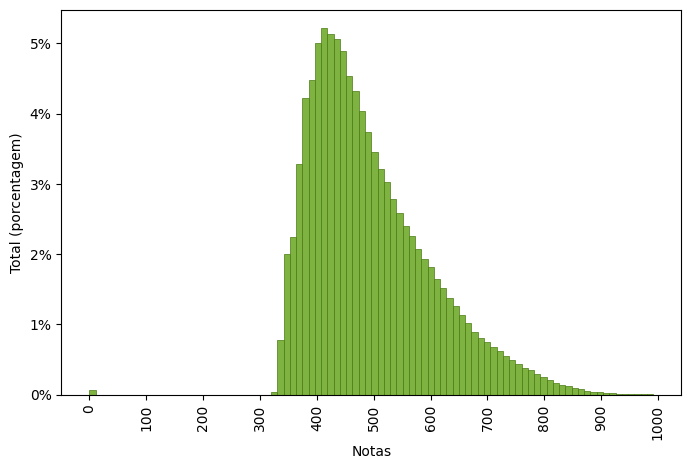

In [49]:
%matplotlib inline
plt.figure(figsize=(8,5)) 
plt.hist(notas_matematica_lista, weights=np.ones(len(notas_matematica_lista)) / len(notas_matematica_lista), bins=90, facecolor = '#7eb342', edgecolor='#477a10', linewidth=0.5)
plt.xticks(notas_intervalos, notas_intervalos, rotation ='vertical')
plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals = 0))
#plt.title('Gráfico 4: Notas da prova de Matemática') 
plt.xlabel('Notas') 
plt.ylabel('Total (porcentagem)') 
plt.savefig("notas_mt.png")
plt.show()


○ Nota da prova de redação

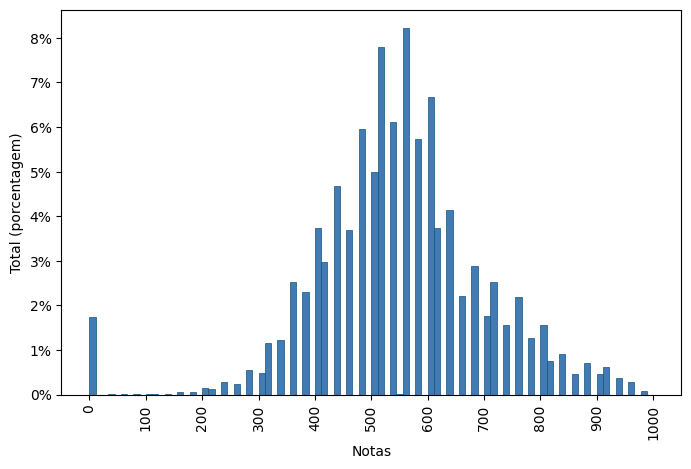

In [50]:
%matplotlib inline
plt.figure(figsize=(8,5)) 
plt.hist(notas_redacao_lista, weights=np.ones(len(notas_redacao_lista)) / len(notas_redacao_lista), bins=90, facecolor = '#427bb3', edgecolor='#10537a', linewidth=0.5)
plt.xticks(notas_intervalos, notas_intervalos, rotation ='vertical')
plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals = 0))
#plt.title('Gráfico 5: Notas da prova de Redação') 
plt.xlabel('Notas') 
plt.ylabel('Total (porcentagem)') 
plt.savefig("notas_red.png")
plt.show()


● Gráfico mostrando a distribuição da UF de residência dos alunos da nossa amostra (percentual em cada estado)

In [51]:
uf_sigla = df_microdados_enem['SG_UF_RESIDENCIA'].value_counts(ascending = False).index
uf_quantidade = df_microdados_enem['SG_UF_RESIDENCIA'].value_counts(ascending = False).values
uf_percentual = df_microdados_enem['SG_UF_RESIDENCIA'].value_counts(normalize=True, ascending = False).values

In [52]:
df_uf_residencia = pd.DataFrame({"UF": uf_sigla,
                      "Quantidade": uf_quantidade,
                     "Percentual": uf_percentual})
df_uf_residencia_formatado = df_uf_residencia.style.hide()
df_uf_residencia_formatado.set_caption("Tabela 9: Distribuição da UF de residência dos alunos")
df_uf_residencia_formatado.format({'Percentual': "{:,.2%}"})
display(df_uf_residencia_formatado)

UF,Quantidade,Percentual
SP,303127,21.84%
MG,131502,9.47%
RJ,94992,6.84%
CE,88077,6.35%
BA,79438,5.72%
PR,77315,5.57%
RS,65511,4.72%
PE,63760,4.59%
PA,57917,4.17%
SC,51234,3.69%


In [53]:
uf_percentual_grafico = df_uf_residencia["Percentual"].apply(lambda x: round(((float(x)) * 100), 2))
uf_percentual_grafico = uf_percentual_grafico.astype(str) + '%'

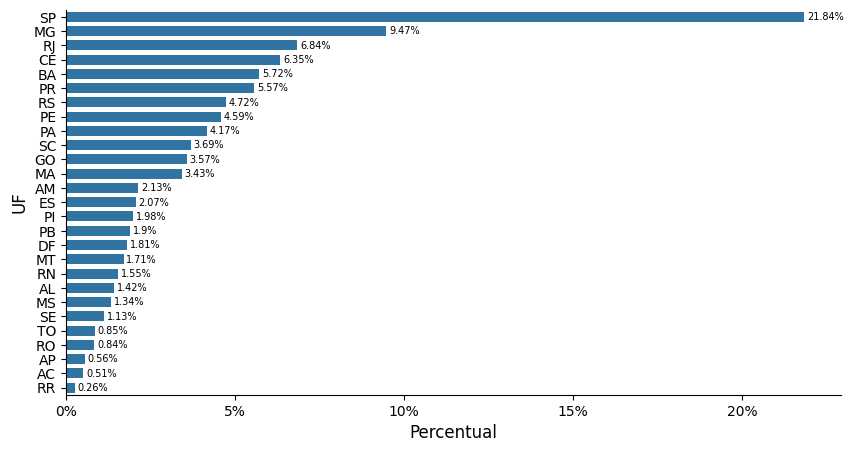

In [54]:
%matplotlib inline
plt.figure(figsize=(10,5))
ax = sns.barplot(data = df_uf_residencia, y = "UF", x = "Percentual", alpha=1, width=0.70, dodge=False)
#plt.title('Gráfico 6: Distribuição da UF de residência dos participantes')
plt.gca().xaxis.set_major_formatter(ticker.PercentFormatter(1, decimals = 0))
plt.ylabel('UF', fontsize=12)
plt.xlabel('Percentual', fontsize=12)
for c in ax.containers:
    labels = uf_percentual_grafico
    ax.bar_label(c, labels, padding=2, fontsize=7)
sns.despine()
plt.savefig("dist_uf.png")
plt.show()

● Tabela com estatísticas descritivas da base de dados (média, desvio-padrão, e quantidade de observações), comparando homens e mulheres da amostra
○ Idade

In [55]:
print(len(df_microdados_enem[df_microdados_enem['TP_SEXO'] == "M"])/len(df_microdados_enem))
print(len(df_microdados_enem[df_microdados_enem['TP_SEXO'] == "F"])/len(df_microdados_enem))

0.42012789219938274
0.5798721078006173


In [56]:
df_microdados_enem["Q001"].value_counts(ascending = True)
print((392002+115860+66926)/len(df_microdados_enem))

0.41409926486480253


In [57]:
idade = df_microdados_enem[["NU_IDADE", "TP_SEXO"]]
idade = idade.dropna()
idade_masculino = idade['NU_IDADE'][idade['TP_SEXO'] == "M"]
idade_feminino = idade['NU_IDADE'][idade['TP_SEXO'] == "F"]

In [58]:
idade_feminino_vc = idade_feminino.value_counts(ascending = False).sort_index()
idade_feminino = idade_feminino.to_numpy()
idade_feminino_media = np.average(idade_feminino)
idade_feminino_desvio_padrao = np.std(idade_feminino)
idade_feminino_valores = idade_feminino_vc.index
idade_feminino_quantidade = idade_feminino_vc.values

In [59]:
idade_masculino_vc = idade_masculino.value_counts(ascending = False).sort_index()
idade_masculino = idade_masculino.to_numpy()
idade_masculino_media = np.average(idade_masculino)
idade_masculino_desvio_padrao = np.std(idade_masculino)
idade_masculino_valores = idade_masculino_vc.index
idade_masculino_quantidade = idade_masculino_vc.values

In [60]:
idade_masculino_series = idade_masculino.squeeze()
intervalo_idade_masculino = pd.cut(idade_masculino_series, bins=[0,15,16,17,18,19,20,30,40,50,80])
intervalo_idade_masculino_quantidade = intervalo_idade_masculino.value_counts().sort_index().values

idade_masculino_intervalos = ["15 anos ou menos", 
                              "16 anos",
                              "17 anos", 
                              "18 anos", 
                              "19 anos",
                              "20 anos",
                              "21 a 30 anos",
                              "31 a 40 anos",
                              "41 a 50 anos",
                              "50 anos ou mais"]

intervalo_idade_masculino_total = sum(intervalo_idade_masculino_quantidade)
arr = np.array(intervalo_idade_masculino_quantidade)
result = arr/intervalo_idade_masculino_total
intervalo_idade_masculino_percentual = result.tolist()

In [61]:
idade_feminino_series = idade_feminino.squeeze()
intervalo_idade_feminino = pd.cut(idade_feminino_series, bins=[0,15,16,17,18,19,20,30,40,50,80])
intervalo_idade_feminino_quantidade = intervalo_idade_feminino.value_counts().sort_index().values

idade_feminino_intervalos = ["15 anos ou menos", 
                              "16 anos",
                              "17 anos", 
                              "18 anos", 
                              "19 anos",
                              "20 anos",
                              "21 a 30 anos",
                              "31 a 40 anos",
                              "41 a 50 anos",
                              "50 anos ou mais"]

intervalo_idade_feminino_total = sum(intervalo_idade_feminino_quantidade)
arr = np.array(intervalo_idade_feminino_quantidade)
result = arr/intervalo_idade_feminino_total
intervalo_idade_feminino_percentual = result.tolist()

In [62]:
print(intervalo_idade_masculino_percentual)
print(intervalo_idade_feminino_percentual)

[0.0011197901036620395, 0.03653122293769131, 0.4927573759528076, 0.31039964331341263, 0.09678210393641376, 0.03327645782781298, 0.02661259206543827, 0.0017182690411475705, 0.0006036234555727992, 0.0001989213660410361]
[0.001556780880295602, 0.04808378040568244, 0.5382361784446107, 0.2892792092099803, 0.07333021894327751, 0.022549095128878597, 0.02177629568151717, 0.0037248436385684076, 0.00117038115661489, 0.00029321651057443105]


○ Raça: percentuais de cada raça declarada e sem resposta (não declarado ou sem informação)

In [63]:
raca = df_microdados_enem[["TP_COR_RACA", "TP_SEXO"]]
raca = raca.dropna()
raca_masculino = raca['TP_COR_RACA'][raca['TP_SEXO'] == "M"]
raca_feminino = raca['TP_COR_RACA'][raca['TP_SEXO'] == "F"]

In [64]:
raca_masculino_vc = raca_masculino.value_counts().sort_index()
raca_feminino_vc = raca_feminino.value_counts().sort_index()

raca_total_masculino = len(raca_masculino)
arr = np.array(raca_masculino_vc)
result = arr/raca_total_masculino
raca_masculino_percentual = result.tolist()

raca_total_feminino = len(raca_feminino)
arr = np.array(raca_feminino_vc)
result = arr/raca_total_feminino
raca_feminino_percentual = result.tolist()

raca_descricao = ["Não declarado", "Branca", "Preta", "Parda", "Amarela", "Indígena", "Sem informação"]

○ Parcela cujo pai tem Ensino Médio completo (categorias E, F, G)

In [65]:
pai = df_microdados_enem[["Q001", "TP_SEXO"]]
pai = pai.dropna()
pai_masculino = pai['Q001'][pai['TP_SEXO'] == "M"]
pai_feminino = pai['Q001'][pai['TP_SEXO'] == "F"]

In [66]:
pai_descricao = ["Sem ensino médio completo", "Com ensino médio completo"]

pai_feminino_total = len(pai_feminino)
pai_feminino_vc = pai_feminino.value_counts().sort_index()

NUNCA_ESTUDOU_FEMININO = pai_feminino_vc["A"]
NAO_COMPLETOU_4_S_EF_FEMININO = pai_feminino_vc["B"]
NAO_COMPLETOU_8_S_EF_FEMININO = pai_feminino_vc["C"]
NAO_COMPLETOU_EM_FEMININO = pai_feminino_vc["D"]
COMPLETOU_EM_FEMININO = pai_feminino_vc["E"]
COMPLETOU_FACULDADE_FEMININO = pai_feminino_vc["F"]
COMPLETOU_POS_FEMININO = pai_feminino_vc["G"]
NAO_SEI_FEMININO = pai_feminino_vc["H"]

pai_feminino_sem_em_total = NUNCA_ESTUDOU_FEMININO + NAO_COMPLETOU_4_S_EF_FEMININO + NAO_COMPLETOU_8_S_EF_FEMININO + NAO_COMPLETOU_EM_FEMININO + NAO_SEI_FEMININO
pai_feminino_com_em_total = COMPLETOU_EM_FEMININO + COMPLETOU_FACULDADE_FEMININO + COMPLETOU_POS_FEMININO

pai_feminino_percentual = [pai_feminino_sem_em_total/pai_feminino_total, pai_feminino_com_em_total/pai_feminino_total]

In [67]:
pai_masculino_total = len(pai_masculino)
pai_masculino_vc = pai_masculino.value_counts().sort_index()

NUNCA_ESTUDOU_MASCULINO = pai_masculino_vc["A"]
NAO_COMPLETOU_4_S_EF_MASCULINO = pai_masculino_vc["B"]
NAO_COMPLETOU_8_S_EF_MASCULINO = pai_masculino_vc["C"]
NAO_COMPLETOU_EM_MASCULINO = pai_masculino_vc["D"]
COMPLETOU_EM_MASCULINO = pai_masculino_vc["E"]
COMPLETOU_FACULDADE_MASCULINO = pai_masculino_vc["F"]
COMPLETOU_POS_MASCULINO = pai_masculino_vc["G"]
NAO_SEI_MASCULINO = pai_masculino_vc["H"]

pai_masculino_sem_em_total = NUNCA_ESTUDOU_MASCULINO + NAO_COMPLETOU_4_S_EF_MASCULINO + NAO_COMPLETOU_8_S_EF_MASCULINO + NAO_COMPLETOU_EM_MASCULINO + NAO_SEI_MASCULINO
pai_masculino_com_em_total = COMPLETOU_EM_MASCULINO + COMPLETOU_FACULDADE_MASCULINO + COMPLETOU_POS_MASCULINO

pai_masculino_percentual = [pai_masculino_sem_em_total/pai_masculino_total, pai_masculino_com_em_total/pai_masculino_total]

○ Parcela cuja mãe tem Ensino Médio completo (categorias E, F, G)

In [68]:
mae = df_microdados_enem[["Q002", "TP_SEXO"]]
mae = mae.dropna()
mae_masculino = mae['Q002'][mae['TP_SEXO'] == "M"]
mae_feminino = mae['Q002'][mae['TP_SEXO'] == "F"]

In [69]:
mae_descricao = ["Sem ensino médio completo", "Com ensino médio completo"]

mae_feminino_total = len(mae_feminino)
mae_feminino_vc = mae_feminino.value_counts().sort_index()

NUNCA_ESTUDOU_FEMININO = mae_feminino_vc["A"]
NAO_COMPLETOU_4_S_EF_FEMININO = mae_feminino_vc["B"]
NAO_COMPLETOU_8_S_EF_FEMININO = mae_feminino_vc["C"]
NAO_COMPLETOU_EM_FEMININO = mae_feminino_vc["D"]
COMPLETOU_EM_FEMININO = mae_feminino_vc["E"]
COMPLETOU_FACULDADE_FEMININO = mae_feminino_vc["F"]
COMPLETOU_POS_FEMININO = mae_feminino_vc["G"]
NAO_SEI_FEMININO = mae_feminino_vc["H"]

mae_feminino_sem_em_total = NUNCA_ESTUDOU_FEMININO + NAO_COMPLETOU_4_S_EF_FEMININO + NAO_COMPLETOU_8_S_EF_FEMININO + NAO_COMPLETOU_EM_FEMININO + NAO_SEI_FEMININO
mae_feminino_com_em_total = COMPLETOU_EM_FEMININO + COMPLETOU_FACULDADE_FEMININO + COMPLETOU_POS_FEMININO

mae_feminino_percentual = [mae_feminino_sem_em_total/mae_feminino_total, mae_feminino_com_em_total/mae_feminino_total]

In [70]:
mae_masculino_total = len(mae_masculino)
mae_masculino_vc = mae_masculino.value_counts().sort_index()

NUNCA_ESTUDOU_MASCULINO = mae_masculino_vc["A"]
NAO_COMPLETOU_4_S_EF_MASCULINO = mae_masculino_vc["B"]
NAO_COMPLETOU_8_S_EF_MASCULINO = mae_masculino_vc["C"]
NAO_COMPLETOU_EM_MASCULINO = mae_masculino_vc["D"]
COMPLETOU_EM_MASCULINO = mae_masculino_vc["E"]
COMPLETOU_FACULDADE_MASCULINO = mae_masculino_vc["F"]
COMPLETOU_POS_MASCULINO = mae_masculino_vc["G"]
NAO_SEI_MASCULINO = mae_masculino_vc["H"]

mae_masculino_sem_em_total = NUNCA_ESTUDOU_MASCULINO + NAO_COMPLETOU_4_S_EF_MASCULINO + NAO_COMPLETOU_8_S_EF_MASCULINO + NAO_COMPLETOU_EM_MASCULINO + NAO_SEI_MASCULINO
mae_masculino_com_em_total = COMPLETOU_EM_MASCULINO + COMPLETOU_FACULDADE_MASCULINO + COMPLETOU_POS_MASCULINO

mae_masculino_percentual = [mae_masculino_sem_em_total/mae_masculino_total, mae_masculino_com_em_total/mae_masculino_total]

○ Dependência administrativa da escola: parcela de estudantes da amostra em cada uma das dependências administrativas

In [71]:
dependencia_administrativa = df_microdados_enem[["TP_DEPENDENCIA_ADM_ESC", "TP_SEXO"]]
dependencia_administrativa = dependencia_administrativa.dropna()
dependencia_administrativa_masculino = dependencia_administrativa['TP_DEPENDENCIA_ADM_ESC'][dependencia_administrativa['TP_SEXO'] == "M"]
dependencia_administrativa_feminino = dependencia_administrativa['TP_DEPENDENCIA_ADM_ESC'][dependencia_administrativa['TP_SEXO'] == "F"]

In [72]:
dependencia_administrativa_descricao = ["Federal", "Estadual", "Municipal", "Privada"]

dependencia_administrativa_masculino_total = len(dependencia_administrativa_masculino)
dependencia_administrativa_masculino_vc = dependencia_administrativa_masculino.value_counts().sort_index()
FEDERAL_MASCULINO = dependencia_administrativa_masculino_vc[1]
ESTADUAL_MASCULINO = dependencia_administrativa_masculino_vc[2]
MUNICIPAL_MASCULINO = dependencia_administrativa_masculino_vc[3]
PRIVADA_MASCULINO = dependencia_administrativa_masculino_vc[4]

dependencia_administrativa_masculino_lista = [FEDERAL_MASCULINO, ESTADUAL_MASCULINO, MUNICIPAL_MASCULINO, PRIVADA_MASCULINO]

In [73]:
dependencia_administrativa_feminino_total = len(dependencia_administrativa_feminino)
dependencia_administrativa_feminino_vc = dependencia_administrativa_feminino.value_counts().sort_index()
FEDERAL_FEMININO = dependencia_administrativa_feminino_vc[1]
ESTADUAL_FEMININO = dependencia_administrativa_feminino_vc[2]
MUNICIPAL_FEMININO = dependencia_administrativa_feminino_vc[3]
PRIVADA_FEMININO = dependencia_administrativa_feminino_vc[4]

dependencia_administrativa_feminino_lista = [FEDERAL_FEMININO, ESTADUAL_FEMININO, MUNICIPAL_FEMININO, PRIVADA_FEMININO]

In [74]:
arr = np.array(dependencia_administrativa_feminino_lista)
result = arr/dependencia_administrativa_feminino_total
dependencia_administrativa_feminino_percentual = result.tolist()

In [75]:
arr = np.array(dependencia_administrativa_masculino_lista)
result = arr/dependencia_administrativa_masculino_total
dependencia_administrativa_masculino_percentual = result.tolist()

○ Nota da prova de Ciências Humanas

In [76]:
nota_ciencias_humanas = df_microdados_enem[["NU_NOTA_CH", "TP_SEXO"]]
nota_ciencias_humanas = nota_ciencias_humanas.dropna()
nota_ciencias_humanas_masculino = nota_ciencias_humanas['NU_NOTA_CH'][nota_ciencias_humanas['TP_SEXO'] == "M"]
nota_ciencias_humanas_feminino = nota_ciencias_humanas['NU_NOTA_CH'][nota_ciencias_humanas['TP_SEXO'] == "F"]

In [77]:
nota_ciencias_humanas_masculino_vc = nota_ciencias_humanas_masculino.value_counts(ascending = False).sort_index()
nota_ciencias_humanas_masculino = nota_ciencias_humanas_masculino.to_numpy()
nota_ciencias_humanas_masculino_media = np.average(nota_ciencias_humanas_masculino)
nota_ciencias_humanas_masculino_desvio_padrao = np.std(nota_ciencias_humanas_masculino)

In [78]:
nota_ciencias_humanas_feminino_vc = nota_ciencias_humanas_feminino.value_counts(ascending = False).sort_index()
nota_ciencias_humanas_feminino = nota_ciencias_humanas_feminino.to_numpy()
nota_ciencias_humanas_feminino_media = np.average(nota_ciencias_humanas_feminino)
nota_ciencias_humanas_feminino_desvio_padrao = np.std(nota_ciencias_humanas_feminino)

In [79]:
nota_ciencias_humanas_masculino_valores = nota_ciencias_humanas_masculino_vc.index
nota_ciencias_humanas_masculino_quantidade = nota_ciencias_humanas_masculino_vc.values
nota_ciencias_humanas_feminino_valores = nota_ciencias_humanas_feminino_vc.index
nota_ciencias_humanas_feminino_quantidade = nota_ciencias_humanas_feminino_vc.values

In [80]:
nota_ciencias_humanas_masculino_series = nota_ciencias_humanas_masculino.squeeze()
intervalo_nota_ciencias_humanas_masculino = pd.cut(nota_ciencias_humanas_masculino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_ciencias_humanas_masculino_quantidade = intervalo_nota_ciencias_humanas_masculino.value_counts().sort_index().values


nota_intervalos = ["(0, 200]","(200, 400]","(400, 600]","(600, 800]","(800, 1000]"]

intervalo_nota_ciencias_humanas_masculino_total = sum(intervalo_nota_ciencias_humanas_masculino_quantidade)
arr = np.array(intervalo_nota_ciencias_humanas_masculino_quantidade)
result = arr/intervalo_nota_ciencias_humanas_masculino_total
intervalo_nota_ciencias_humanas_masculino_percentual = result.tolist()

In [81]:
nota_ciencias_humanas_feminino_series = nota_ciencias_humanas_feminino.squeeze()
intervalo_nota_ciencias_humanas_feminino = pd.cut(nota_ciencias_humanas_feminino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_ciencias_humanas_feminino_quantidade = intervalo_nota_ciencias_humanas_feminino.value_counts().sort_index().values

intervalo_nota_ciencias_humanas_feminino_total = sum(intervalo_nota_ciencias_humanas_feminino_quantidade)
arr = np.array(intervalo_nota_ciencias_humanas_feminino_quantidade)
result = arr/intervalo_nota_ciencias_humanas_feminino_total
intervalo_nota_ciencias_humanas_feminino_percentual = result.tolist()

○ Nota da prova de Ciências da Natureza

In [82]:
nota_ciencias_da_natureza = df_microdados_enem[["NU_NOTA_CN", "TP_SEXO"]]
nota_ciencias_da_natureza = nota_ciencias_da_natureza.dropna()
nota_ciencias_da_natureza_masculino = nota_ciencias_da_natureza['NU_NOTA_CN'][nota_ciencias_da_natureza['TP_SEXO'] == "M"]
nota_ciencias_da_natureza_feminino = nota_ciencias_da_natureza['NU_NOTA_CN'][nota_ciencias_da_natureza['TP_SEXO'] == "F"]

In [83]:
nota_ciencias_da_natureza_feminino_vc = nota_ciencias_da_natureza_feminino.value_counts(ascending = False).sort_index()
nota_ciencias_da_natureza_feminino = nota_ciencias_da_natureza_feminino.to_numpy()
nota_ciencias_da_natureza_feminino_media = np.average(nota_ciencias_da_natureza_feminino)
nota_ciencias_da_natureza_feminino_desvio_padrao = np.std(nota_ciencias_da_natureza_feminino)

In [84]:
nota_ciencias_da_natureza_masculino_vc = nota_ciencias_da_natureza_masculino.value_counts(ascending = False).sort_index()
nota_ciencias_da_natureza_masculino = nota_ciencias_da_natureza_masculino.to_numpy()
nota_ciencias_da_natureza_masculino_media = np.average(nota_ciencias_da_natureza_masculino)
nota_ciencias_da_natureza_masculino_desvio_padrao = np.std(nota_ciencias_da_natureza_masculino)

In [85]:
nota_ciencias_da_natureza_masculino_valores = nota_ciencias_da_natureza_masculino_vc.index
nota_ciencias_da_natureza_masculino_quantidade = nota_ciencias_da_natureza_masculino_vc.values
nota_ciencias_da_natureza_feminino_valores = nota_ciencias_da_natureza_feminino_vc.index
nota_ciencias_da_natureza_feminino_quantidade = nota_ciencias_da_natureza_feminino_vc.values

In [86]:
nota_ciencias_da_natureza_masculino_series = nota_ciencias_da_natureza_masculino.squeeze()
intervalo_nota_ciencias_da_natureza_masculino = pd.cut(nota_ciencias_da_natureza_masculino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_ciencias_da_natureza_masculino_quantidade = intervalo_nota_ciencias_da_natureza_masculino.value_counts().sort_index().values

intervalo_nota_ciencias_da_natureza_masculino_total = sum(intervalo_nota_ciencias_da_natureza_masculino_quantidade)
arr = np.array(intervalo_nota_ciencias_da_natureza_masculino_quantidade)
result = arr/intervalo_nota_ciencias_da_natureza_masculino_total
intervalo_nota_ciencias_da_natureza_masculino_percentual = result.tolist()

In [87]:
nota_ciencias_da_natureza_feminino_series = nota_ciencias_da_natureza_feminino.squeeze()
intervalo_nota_ciencias_da_natureza_feminino = pd.cut(nota_ciencias_da_natureza_feminino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_ciencias_da_natureza_feminino_quantidade = intervalo_nota_ciencias_da_natureza_feminino.value_counts().sort_index().values

intervalo_nota_ciencias_da_natureza_feminino_total = sum(intervalo_nota_ciencias_da_natureza_feminino_quantidade)
arr = np.array(intervalo_nota_ciencias_da_natureza_feminino_quantidade)
result = arr/intervalo_nota_ciencias_da_natureza_feminino_total
intervalo_nota_ciencias_da_natureza_feminino_percentual = result.tolist()

○ Nota da prova de Linguagens e Códigos

In [88]:
df_m = df_microdados_enem[df_microdados_enem['TP_SEXO'] == "M"]
df_f = df_microdados_enem[df_microdados_enem['TP_SEXO'] == "F"]

In [89]:
print(len(df_m))
print(len(df_f))

583156
804888


In [90]:
nota_linguagens = df_microdados_enem[["NU_NOTA_LC", "TP_SEXO"]]
nota_linguagens = nota_linguagens.dropna()
nota_linguagens_masculino = nota_linguagens['NU_NOTA_LC'][nota_linguagens['TP_SEXO'] == "M"]
nota_linguagens_feminino = nota_linguagens['NU_NOTA_LC'][nota_linguagens['TP_SEXO'] == "F"]

In [91]:
nota_linguagens_feminino_vc = nota_linguagens_feminino.value_counts(ascending = False).sort_index()
nota_linguagens_feminino = nota_linguagens_feminino.to_numpy()
nota_linguagens_feminino_media = np.average(nota_linguagens_feminino)
nota_linguagens_feminino_desvio_padrao = np.std(nota_linguagens_feminino)

In [92]:
nota_linguagens_masculino_vc = nota_linguagens_masculino.value_counts(ascending = False).sort_index()
nota_linguagens_masculino = nota_linguagens_masculino.to_numpy()
nota_linguagens_masculino_media = np.average(nota_linguagens_masculino)
nota_linguagens_masculino_desvio_padrao = np.std(nota_linguagens_masculino)

In [93]:
nota_linguagens_masculino_valores = nota_linguagens_masculino_vc.index
nota_linguagens_masculino_quantidade = nota_linguagens_masculino_vc.values
nota_linguagens_feminino_valores = nota_linguagens_feminino_vc.index
nota_linguagens_feminino_quantidade = nota_linguagens_feminino_vc.values

In [94]:
nota_linguagens_masculino_series = nota_linguagens_masculino.squeeze()
intervalo_nota_linguagens_masculino = pd.cut(nota_linguagens_masculino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_linguagens_masculino_quantidade = intervalo_nota_linguagens_masculino.value_counts().sort_index().values

intervalo_nota_linguagens_masculino_total = sum(intervalo_nota_linguagens_masculino_quantidade)
arr = np.array(intervalo_nota_linguagens_masculino_quantidade)
result = arr/intervalo_nota_linguagens_masculino_total
intervalo_nota_linguagens_masculino_percentual = result.tolist()

In [95]:
nota_linguagens_feminino_series = nota_linguagens_feminino.squeeze()
intervalo_nota_linguagens_feminino = pd.cut(nota_linguagens_feminino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_linguagens_feminino_quantidade = intervalo_nota_linguagens_feminino.value_counts().sort_index().values

intervalo_nota_linguagens_feminino_total = sum(intervalo_nota_linguagens_feminino_quantidade)
arr = np.array(intervalo_nota_linguagens_feminino_quantidade)
result = arr/intervalo_nota_linguagens_feminino_total
intervalo_nota_linguagens_feminino_percentual = result.tolist()

○ Nota da prova de Matemática

In [96]:
nota_matematica = df_microdados_enem[["NU_NOTA_MT", "TP_SEXO"]]
nota_matematica = nota_matematica.dropna()
nota_matematica_masculino = nota_matematica['NU_NOTA_MT'][nota_matematica['TP_SEXO'] == "M"]
nota_matematica_feminino = nota_matematica['NU_NOTA_MT'][nota_matematica['TP_SEXO'] == "F"]

In [97]:
nota_matematica_feminino_vc = nota_matematica_feminino.value_counts(ascending = False).sort_index()
nota_matematica_feminino = nota_matematica_feminino.to_numpy()
nota_matematica_feminino_media = np.average(nota_matematica_feminino)
nota_matematica_feminino_desvio_padrao = np.std(nota_matematica_feminino)

In [98]:
nota_matematica_masculino_vc = nota_matematica_masculino.value_counts(ascending = False).sort_index()
nota_matematica_masculino = nota_matematica_masculino.to_numpy()
nota_matematica_masculino_media = np.average(nota_matematica_masculino)
nota_matematica_masculino_desvio_padrao = np.std(nota_matematica_masculino)

In [99]:
nota_matematica_masculino_valores = nota_matematica_masculino_vc.index
nota_matematica_masculino_quantidade = nota_matematica_masculino_vc.values
nota_matematica_feminino_valores = nota_matematica_feminino_vc.index
nota_matematica_feminino_quantidade = nota_matematica_feminino_vc.values

In [100]:
nota_matematica_masculino_series = nota_matematica_masculino.squeeze()
intervalo_nota_matematica_masculino = pd.cut(nota_matematica_masculino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_matematica_masculino_quantidade = intervalo_nota_matematica_masculino.value_counts().sort_index().values

intervalo_nota_matematica_masculino_total = sum(intervalo_nota_matematica_masculino_quantidade)
arr = np.array(intervalo_nota_matematica_masculino_quantidade)
result = arr/intervalo_nota_matematica_masculino_total
intervalo_nota_matematica_masculino_percentual = result.tolist()

In [101]:
nota_matematica_feminino_series = nota_matematica_feminino.squeeze()
intervalo_nota_matematica_feminino = pd.cut(nota_matematica_feminino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_matematica_feminino_quantidade = intervalo_nota_matematica_feminino.value_counts().sort_index().values

intervalo_nota_matematica_feminino_total = sum(intervalo_nota_matematica_feminino_quantidade)
arr = np.array(intervalo_nota_matematica_feminino_quantidade)
result = arr/intervalo_nota_matematica_feminino_total
intervalo_nota_matematica_feminino_percentual = result.tolist()

In [102]:
nota_ciencias_humanas_masculino_tamanho = len(nota_ciencias_humanas_masculino)
nota_ciencias_humanas_feminino_tamanho = len(nota_ciencias_humanas_feminino)
print(nota_ciencias_humanas_masculino_tamanho)
print(nota_ciencias_humanas_feminino_tamanho)
t_statistic, p_value = stats.ttest_ind_from_stats(nota_ciencias_humanas_feminino_media, nota_ciencias_humanas_feminino_desvio_padrao, nota_ciencias_humanas_feminino_tamanho, 
                                                  nota_ciencias_humanas_masculino_media, nota_ciencias_humanas_masculino_desvio_padrao, nota_ciencias_humanas_masculino_tamanho)
print(t_statistic)
print(p_value)

583156
804888
-92.8834
0.0


○ Nota da prova de Redação

In [103]:
nota_redacao = df_microdados_enem[["NU_NOTA_REDACAO", "TP_SEXO"]]
nota_redacao = nota_redacao.dropna()
nota_redacao_masculino = nota_redacao['NU_NOTA_REDACAO'][nota_redacao['TP_SEXO'] == "M"]
nota_redacao_feminino = nota_redacao['NU_NOTA_REDACAO'][nota_redacao['TP_SEXO'] == "F"]

In [104]:
nota_redacao_feminino_vc = nota_redacao_feminino.value_counts(ascending = False).sort_index()
nota_redacao_feminino = nota_redacao_feminino.to_numpy()
nota_redacao_feminino_media = np.average(nota_redacao_feminino)
nota_redacao_feminino_desvio_padrao = np.std(nota_redacao_feminino)

In [105]:
nota_redacao_masculino_vc = nota_redacao_masculino.value_counts(ascending = False).sort_index()
nota_redacao_masculino = nota_redacao_masculino.to_numpy()
nota_redacao_masculino_media = np.average(nota_redacao_masculino)
nota_redacao_masculino_desvio_padrao = np.std(nota_redacao_masculino)

In [106]:
nota_redacao_masculino_valores = nota_redacao_masculino_vc.index
nota_redacao_masculino_quantidade = nota_redacao_masculino_vc.values
nota_redacao_feminino_valores = nota_redacao_feminino_vc.index
nota_redacao_feminino_quantidade = nota_redacao_feminino_vc.values

In [107]:
nota_redacao_masculino_series = nota_redacao_masculino.squeeze()
intervalo_nota_redacao_masculino = pd.cut(nota_redacao_masculino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_redacao_masculino_quantidade = intervalo_nota_redacao_masculino.value_counts().sort_index().values

intervalo_nota_redacao_masculino_total = sum(intervalo_nota_redacao_masculino_quantidade)
arr = np.array(intervalo_nota_redacao_masculino_quantidade)
result = arr/intervalo_nota_redacao_masculino_total
intervalo_nota_redacao_masculino_percentual = result.tolist()

In [108]:
nota_redacao_feminino_series = nota_redacao_feminino.squeeze()
intervalo_nota_redacao_feminino = pd.cut(nota_redacao_feminino_series, bins=[0,200,400,600,800,1000])
intervalo_nota_redacao_feminino_quantidade = intervalo_nota_redacao_feminino.value_counts().sort_index().values

intervalo_nota_redacao_feminino_total = sum(intervalo_nota_redacao_feminino_quantidade)
arr = np.array(intervalo_nota_redacao_feminino_quantidade)
result = arr/intervalo_nota_redacao_feminino_total
intervalo_nota_redacao_feminino_percentual = result.tolist()

In [109]:
df_tabela_estatisticas = pd.DataFrame(columns = ['Gênero', 'Estatística', 'Variável', 'Valor'])
row1 = {"Gênero" : "Masculino", "Estatística" : "Média", "Variável" : "Idade", "Valor" : idade_masculino_media}
row2 = {"Gênero" : "Feminino", "Estatística" : "Média", "Variável" : "Idade", "Valor" : idade_feminino_media}
row3 = {"Gênero" : "Masculino", "Estatística" : "Desvio padrão", "Variável" : "Idade", "Valor" : idade_masculino_desvio_padrao}
row4 = {"Gênero" : "Feminino", "Estatística" : "Desvio padrão", "Variável" : "Idade", "Valor" : idade_feminino_desvio_padrao}

row5 = {"Gênero" : "Masculino", "Estatística" : "Média", "Variável" : "Nota Ciências Humanas", "Valor" : nota_ciencias_humanas_masculino_media}
row6 = {"Gênero" : "Feminino", "Estatística" : "Média", "Variável" : "Nota Ciências Humanas", "Valor" : nota_ciencias_humanas_feminino_media}
row7 = {"Gênero" : "Masculino", "Estatística" : "Desvio padrão", "Variável" : "Nota Ciências Humanas", "Valor" : nota_ciencias_humanas_masculino_desvio_padrao}
row8 = {"Gênero" : "Feminino", "Estatística" : "Desvio padrão", "Variável" : "Nota Ciências Humanas", "Valor" : nota_ciencias_humanas_feminino_desvio_padrao}

row9 = {"Gênero" : "Masculino", "Estatística" : "Média", "Variável" : "Nota Ciências da Natureza", "Valor" : nota_ciencias_da_natureza_masculino_media}
row10 = {"Gênero" : "Feminino", "Estatística" : "Média", "Variável" : "Nota Ciências da Natureza", "Valor" : nota_ciencias_da_natureza_feminino_media}
row11 = {"Gênero" : "Masculino", "Estatística" : "Desvio padrão", "Variável" : "Nota Ciências da Natureza", "Valor" : nota_ciencias_da_natureza_masculino_desvio_padrao}
row12 = {"Gênero" : "Feminino", "Estatística" : "Desvio padrão", "Variável" : "Nota Ciências da Natureza", "Valor" : nota_ciencias_da_natureza_feminino_desvio_padrao}

row13 = {"Gênero" : "Masculino", "Estatística" : "Média", "Variável" : "Nota Matemática", "Valor" : nota_matematica_masculino_media}
row14 = {"Gênero" : "Feminino", "Estatística" : "Média", "Variável" : "Nota Matemática", "Valor" : nota_matematica_feminino_media}
row15 = {"Gênero" : "Masculino", "Estatística" : "Desvio padrão", "Variável" : "Nota Matemática", "Valor" : nota_matematica_masculino_desvio_padrao}
row16 = {"Gênero" : "Feminino", "Estatística" : "Desvio padrão", "Variável" : "Nota Matemática", "Valor" : nota_matematica_feminino_desvio_padrao}

row17 = {"Gênero" : "Masculino", "Estatística" : "Média", "Variável" : "Nota Linguagens", "Valor" : nota_linguagens_masculino_media}
row18 = {"Gênero" : "Feminino", "Estatística" : "Média", "Variável" : "Nota Linguagens", "Valor" : nota_linguagens_feminino_media}
row19 = {"Gênero" : "Masculino", "Estatística" : "Desvio padrão", "Variável" : "Nota Linguagens", "Valor" : nota_linguagens_masculino_desvio_padrao}
row20 = {"Gênero" : "Feminino", "Estatística" : "Desvio padrão", "Variável" : "Nota Linguagens", "Valor" : nota_linguagens_feminino_desvio_padrao}

row21 = {"Gênero" : "Masculino", "Estatística" : "Média", "Variável" : "Nota Redação", "Valor" : nota_redacao_masculino_media}
row22 = {"Gênero" : "Feminino", "Estatística" : "Média", "Variável" : "Nota Redação", "Valor" : nota_redacao_feminino_media}
row23 = {"Gênero" : "Masculino", "Estatística" : "Desvio padrão", "Variável" : "Nota Redação", "Valor" : nota_redacao_masculino_desvio_padrao}
row24 = {"Gênero" : "Feminino", "Estatística" : "Desvio padrão", "Variável" : "Nota Redação", "Valor" : nota_redacao_feminino_desvio_padrao}



df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row1])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row2])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row3])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row4])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row5])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row6])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row7])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row8])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row9])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row10])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row11])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row12])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row13])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row14])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row15])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row16])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row17])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row18])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row19])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row20])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row21])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row22])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row23])])
df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row24])])

C:\Users\sacer\AppData\Local\Temp\ipykernel_17652\3620262568.py:34: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_tabela_estatisticas = pd.concat([df_tabela_estatisticas, pd.DataFrame([row1])])


In [110]:
df_tabela_estatisticas_pivot = pd.pivot_table(df_tabela_estatisticas, values= 'Valor', 
                                index=[ 'Variável'], 
                                columns=['Gênero','Estatística'], 
                                aggfunc=np.mean,
                                fill_value=0)
df_tabela_estatisticas_pivot_formatado = df_tabela_estatisticas_pivot.style.set_caption("Tabela 10: Tabulação de estatísticas")
df_tabela_estatisticas_pivot_formatado.format('{:,.2f}')
display(df_tabela_estatisticas_pivot_formatado)

C:\Users\sacer\AppData\Local\Temp\ipykernel_17652\85121330.py:1: FutureWarning: The provided callable <function mean at 0x000002119B25E3E0> is currently using DataFrameGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df_tabela_estatisticas_pivot = pd.pivot_table(df_tabela_estatisticas, values= 'Valor',


In [111]:
print(len(nota_redacao['TP_SEXO'] == "M"))
print(len(nota_redacao['TP_SEXO'] == "F"))


1388044
1388044


In [112]:
df_tabela_observacoes = pd.DataFrame(columns= ['Gênero', 'Variável', 'Descrição', 'Valor'])
for i in range(len(intervalo_idade_feminino_percentual)):
    row1 = {"Gênero" : "Feminino", "Variável" : "Idade", "Descrição" : idade_feminino_intervalos[i], "Valor" : intervalo_idade_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Variável" : "Idade", "Descrição" : idade_masculino_intervalos[i], "Valor" : intervalo_idade_masculino_percentual[i]}
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row2])])

for i in range(len(raca_descricao)):
    row1 = {"Gênero" : "Feminino", "Variável" : "Raça", "Descrição" : raca_descricao[i], "Valor" : raca_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Variável" : "Raça", "Descrição" : raca_descricao[i], "Valor" : raca_masculino_percentual[i]}
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row2])])

for i in range(len(pai_descricao)):
    row1 = {"Gênero" : "Feminino", "Variável" : "Escolaridade pai", "Descrição" : pai_descricao[i], "Valor" : pai_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Variável" : "Escolaridade pai", "Descrição" : pai_descricao[i], "Valor" : pai_masculino_percentual[i]}
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row2])])

for i in range(len(mae_descricao)):
    row1 = {"Gênero" : "Feminino", "Variável" : "Escolaridade mãe", "Descrição" : mae_descricao[i], "Valor" : mae_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Variável" : "Escolaridade mãe", "Descrição" : mae_descricao[i], "Valor" : mae_masculino_percentual[i]}
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row2])])

for i in range(len(dependencia_administrativa_descricao)):
    row1 = {"Gênero" : "Feminino", "Variável" : "Dependência administrativa", "Descrição" : dependencia_administrativa_descricao[i], "Valor" : dependencia_administrativa_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Variável" : "Dependência administrativa", "Descrição" : dependencia_administrativa_descricao[i], "Valor" : dependencia_administrativa_masculino_percentual[i]}
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])
    df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row2])])


C:\Users\sacer\AppData\Local\Temp\ipykernel_17652\2597552354.py:5: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_tabela_observacoes = pd.concat([df_tabela_observacoes, pd.DataFrame([row1])])


In [113]:
df_tabela_observacoes_pivot = df_tabela_observacoes.pivot(values= 'Valor', 
                                index=['Variável', 'Descrição'], 
                                columns=['Gênero'])
df_tabela_observacoes_pivot_formatado = df_tabela_observacoes_pivot.style.format('{:,.2%}')
df_tabela_observacoes_pivot_formatado.set_caption("Tabela 11: Tabulação de observações socioeconômicas")
display(df_tabela_observacoes_pivot_formatado)

In [114]:
df_tabela_observacoes_nota = pd.DataFrame(columns= ['Gênero', 'Prova', 'Intervalo', 'Valor'])
for i in range(len(nota_intervalos)):
    row1 = {"Gênero" : "Feminino", "Prova" : "Ciências Humanas", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_ciencias_humanas_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Prova" : "Ciências Humanas", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_ciencias_humanas_masculino_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

for i in range(len(nota_intervalos)):
    row1 = {"Gênero" : "Feminino", "Prova" : "Ciências da Natureza", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_ciencias_da_natureza_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Prova" : "Ciências da Natureza", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_ciencias_da_natureza_masculino_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

for i in range(len(nota_intervalos)):
    row1 = {"Gênero" : "Feminino", "Prova" : "Linguagens", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_linguagens_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Prova" : "Linguagens", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_linguagens_masculino_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

for i in range(len(nota_intervalos)):
    row1 = {"Gênero" : "Feminino", "Prova" : "Matemática", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_matematica_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Prova" : "Matemática", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_matematica_masculino_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

for i in range(len(nota_intervalos)):
    row1 = {"Gênero" : "Feminino", "Prova" : "Redação", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_redacao_feminino_percentual[i]}
    row2 = {"Gênero" : "Masculino", "Prova" : "Redação", "Intervalo" : nota_intervalos[i], "Valor" : intervalo_nota_redacao_masculino_percentual[i]}
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])
    df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row2])])

C:\Users\sacer\AppData\Local\Temp\ipykernel_17652\2962035206.py:5: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_tabela_observacoes_nota = pd.concat([df_tabela_observacoes_nota, pd.DataFrame([row1])])


In [115]:
df_tabela_observacoes_nota_pivot = df_tabela_observacoes_nota.pivot(values= ['Valor'], 
                                index=['Intervalo'], 
                                columns=['Prova', 'Gênero'])
df_tabela_observacoes_nota_pivot_formatado = df_tabela_observacoes_nota_pivot.style.format('{:,.2%}')
df_tabela_observacoes_nota_pivot_formatado.set_caption("Tabela 12: Tabulação de observações de notas")
display(df_tabela_observacoes_nota_pivot_formatado)

● Gráfico de distribuição das notas por gênero (density plots)

○ Nota da prova de redação

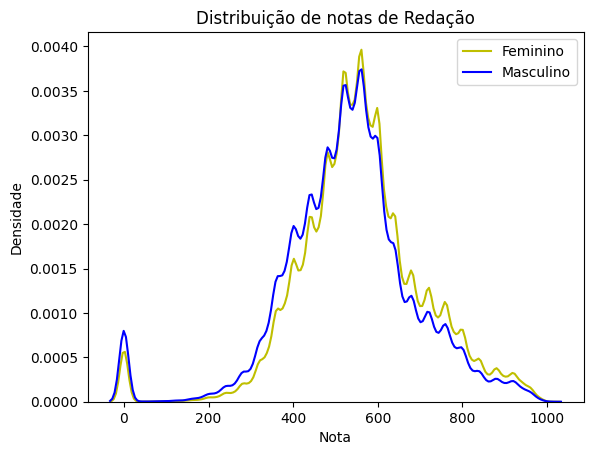

In [116]:
fig = sns.kdeplot(nota_redacao_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_redacao_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Redação")
plt.legend()
plt.show()

○ Nota da prova de Ciências Humanas

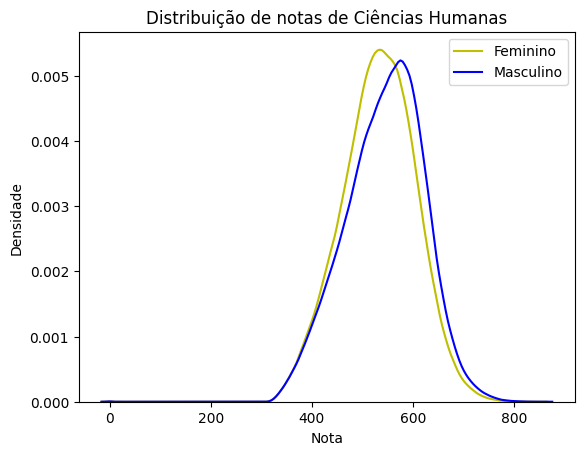

In [117]:
fig = sns.kdeplot(nota_ciencias_humanas_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_ciencias_humanas_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Ciências Humanas")
plt.legend()
plt.show()

○ Nota da prova de Ciências da Natureza

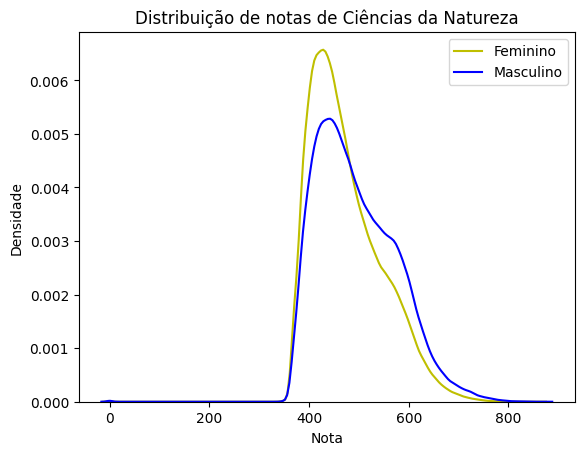

In [118]:
fig = sns.kdeplot(nota_ciencias_da_natureza_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_ciencias_da_natureza_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Ciências da Natureza")
plt.legend()
plt.show()

○ Nota da prova de Linguagens e Códigos

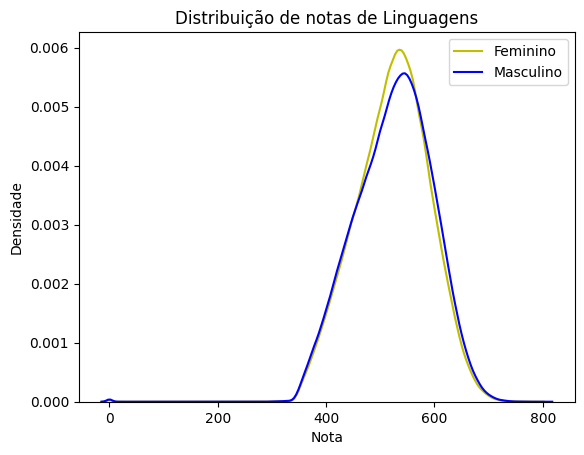

In [119]:
fig = sns.kdeplot(nota_linguagens_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_linguagens_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Linguagens")
plt.legend()
plt.show()

○ Nota da prova de Matemática

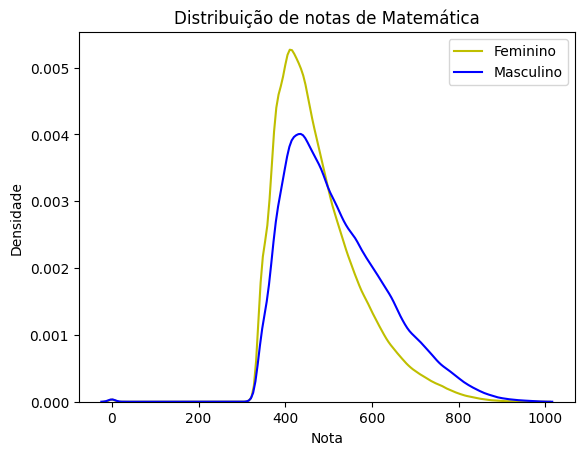

In [120]:
fig = sns.kdeplot(nota_matematica_feminino, color="y", label = "Feminino")
fig = sns.kdeplot(nota_matematica_masculino, color="b", label = "Masculino")
fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas de Matemática")
plt.legend()
plt.show()

In [121]:
from matplotlib.lines import Line2D

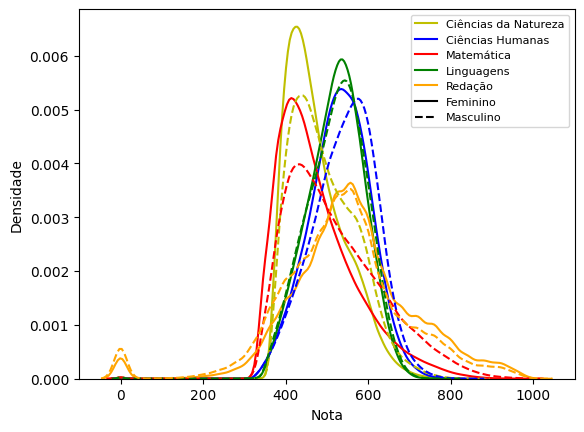

In [122]:
%matplotlib inline
fig = sns.kdeplot(nota_ciencias_da_natureza_feminino, color="y", label = "C. Natureza (fem)", bw_method=0.1)
fig = sns.kdeplot(nota_ciencias_humanas_feminino, color="b", label = "C. Humanas (fem)", bw_method=0.1)
fig = sns.kdeplot(nota_matematica_feminino, color="r", label = "Matemática (fem)", bw_method=0.1)
fig = sns.kdeplot(nota_linguagens_feminino, color="g", label = "Linguagens (fem)", bw_method=0.1)
fig = sns.kdeplot(nota_redacao_feminino, color="orange", label = "Redação (fem)", bw_method=0.1)
fig = sns.kdeplot(nota_ciencias_da_natureza_masculino, color="y", linestyle='--',  label = "C. Natureza (masc)", bw_method=0.1)
fig = sns.kdeplot(nota_ciencias_humanas_masculino, color="b", linestyle='--',  label = "C. Humanas (masc)", bw_method=0.1)
fig = sns.kdeplot(nota_matematica_masculino, color="r", linestyle='--', label = "Matemática (masc)", bw_method=0.1)
fig = sns.kdeplot(nota_linguagens_masculino, color="g", linestyle='--', label = "Linguagens (masc)", bw_method=0.1)
fig = sns.kdeplot(nota_redacao_masculino, color="orange", linestyle='--', label = "Redação (masc)", bw_method=0.1)
cn = Line2D([0,1],[0,1],linestyle='-', color='y')
ch = Line2D([0,1],[0,1],linestyle='-', color='b')
mtm = Line2D([0,1],[0,1],linestyle='-', color='r')
ling = Line2D([0,1],[0,1],linestyle='-', color='g')
red = Line2D([0,1],[0,1],linestyle='-', color='orange')
masc = Line2D([0,1],[0,1],linestyle='--', color='black')
fem = Line2D([0,1],[0,1],linestyle='-', color='black')
#fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas do gênero feminino")
fig.set(xlabel='Nota', ylabel='Densidade')
plt.legend([cn, ch, mtm, ling, red, fem, masc], ['Ciências da Natureza', 'Ciências Humanas', 'Matemática', 'Linguagens', 
                                                      'Redação', 'Feminino', 'Masculino'], loc = 'upper right', fontsize="8")
plt.savefig("distribuicao_notas_enem.pdf", format="pdf", bbox_inches='tight')
plt.show()

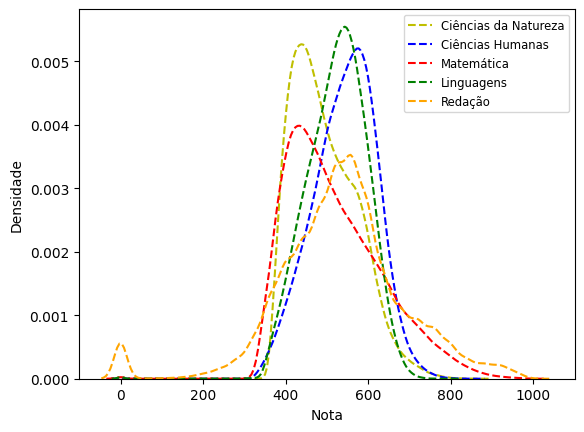

In [123]:
%matplotlib inline
fig = sns.kdeplot(nota_ciencias_da_natureza_masculino, color="y", linestyle='--',  label = "Ciências da Natureza", bw_method=0.1)
fig = sns.kdeplot(nota_ciencias_humanas_masculino, color="b", linestyle='--',  label = "Ciências Humanas", bw_method=0.1)
fig = sns.kdeplot(nota_matematica_masculino, color="r", linestyle='--', label = "Matemática", bw_method=0.1)
fig = sns.kdeplot(nota_linguagens_masculino, color="g", linestyle='--', label = "Linguagens", bw_method=0.1)
fig = sns.kdeplot(nota_redacao_masculino, color="orange", linestyle='--', label = "Redação", bw_method=0.1)
#fig.set(xlabel='Nota', ylabel='Densidade', title = "Distribuição de notas do gênero feminino")
fig.set(xlabel='Nota', ylabel='Densidade')
plt.legend(loc = 'upper right', fontsize = 'small')
plt.savefig("distribuicao_notas_masculino.pdf", format="pdf", bbox_inches='tight')
plt.show()

In [124]:
df_microdados_enem.to_parquet("ENEM_2016_resumido.parquet")